In [1]:
import pandas as pd
import numpy as np
import datetime as dt
from datetime import timedelta
import seaborn as sns
import matplotlib.pyplot as plt

import statsmodels.api as sm


from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error,mean_squared_error

%matplotlib inline
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 800000)


In [2]:
# read clean sales data
sales=pd.read_csv('..\datasets\sales_df.csv')
sales.head(2)

,Invoice,InvoiceDate,StockCode,Item Description,Price,Quantity,Revenue,Customer ID,Country,Inv_Date,Inv_Time,Yr,Month,MMYY
0,489434,2009-12-01 07:45:00,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,6.95,12,83.4,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09
1,489434,2009-12-01 07:45:00,79323P,PINK CHERRY LIGHTS,6.75,12,81.0,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09


In [3]:
sales['InvoiceDate']=pd.to_datetime(sales['InvoiceDate'])

In [4]:
# create function that truncates a given date object to a first day of the month
def get_month(x): return dt.datetime(x.year,x.month,1)

In [5]:
# apply to invoice date to create an invoice month column
sales['InvoiceMonth']=sales['InvoiceDate'].apply(get_month)

In [6]:
# sales['month_year']=pd.to_datetime(sales['InvoiceDate']).dt.to_period('M')

In [7]:
sales.head(2)

,Invoice,InvoiceDate,StockCode,Item Description,Price,Quantity,Revenue,Customer ID,Country,Inv_Date,Inv_Time,Yr,Month,MMYY,InvoiceMonth
0,489434,2009-12-01 07:45:00,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,6.95,12,83.4,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01
1,489434,2009-12-01 07:45:00,79323P,PINK CHERRY LIGHTS,6.75,12,81.0,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01


In [8]:
grouping=sales.groupby('Customer ID')['InvoiceMonth']
grouping

In [9]:
a=grouping.transform('min')
a

0        2009-12-01
1        2009-12-01
2        2009-12-01
3        2009-12-01
4        2009-12-01
5        2009-12-01
6        2009-12-01
7        2009-12-01
8        2009-12-01
9        2009-12-01
10       2009-12-01
11       2009-12-01
12       2009-12-01
13       2009-12-01
14       2009-12-01
15       2009-12-01
16       2009-12-01
17       2009-12-01
18       2009-12-01
19       2009-12-01
20       2009-12-01
21       2009-12-01
22       2009-12-01
23       2009-12-01
24       2009-12-01
25       2009-12-01
26       2009-12-01
27       2009-12-01
28       2009-12-01
29       2009-12-01
30       2009-12-01
31       2009-12-01
32       2009-12-01
33       2009-12-01
34       2009-12-01
35       2009-12-01
36       2009-12-01
37       2009-12-01
38       2009-12-01
39       2009-12-01
40       2009-12-01
41       2009-12-01
42       2009-12-01
43       2009-12-01
44       2009-12-01
45       2009-12-01
46       2009-12-01
47       2009-12-01
48       2009-12-01
49       2009-12-01


In [10]:
# assign the smallest inv month value to each customer
sales['CohortMonth']=grouping.transform('min')

In [11]:
sales.head()

,Invoice,InvoiceDate,StockCode,Item Description,Price,Quantity,Revenue,Customer ID,Country,Inv_Date,Inv_Time,Yr,Month,MMYY,InvoiceMonth,CohortMonth
0,489434,2009-12-01 07:45:00,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,6.95,12,83.4,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01,2009-12-01
1,489434,2009-12-01 07:45:00,79323P,PINK CHERRY LIGHTS,6.75,12,81.0,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01,2009-12-01
2,489434,2009-12-01 07:45:00,79323W,WHITE CHERRY LIGHTS,6.75,12,81.0,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01,2009-12-01
3,489434,2009-12-01 07:45:00,22041,"RECORD FRAME 7"" SINGLE SIZE",2.10,48,100.8,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01,2009-12-01
4,489434,2009-12-01 07:45:00,21232,STRAWBERRY CERAMIC TRINKET BOX,1.25,24,30.0,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01,2009-12-01


In [12]:
def get_date_int(df,column):
    year=df[column].dt.year
    month=df[column].dt.month
    day=df[column].dt.day
    return year,month,day

In [13]:
# calculate the number of months between any transaction and the first transaction for each customer
invoice_year, invoice_month,_=get_date_int(sales,'InvoiceMonth')
cohort_year,cohort_month,_=get_date_int(sales,'CohortMonth')

In [14]:
years_diff=invoice_year-cohort_year
months_diff=invoice_month-cohort_month

In [15]:
# convert the total difference to months
#+1 to indicate first month instead of 0 for easier interpretation
sales['CohortIndex']=years_diff*12+months_diff+1
sales.head()

,Invoice,InvoiceDate,StockCode,Item Description,Price,Quantity,Revenue,Customer ID,Country,Inv_Date,Inv_Time,Yr,Month,MMYY,InvoiceMonth,CohortMonth,CohortIndex
0,489434,2009-12-01 07:45:00,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,6.95,12,83.4,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01,2009-12-01,1
1,489434,2009-12-01 07:45:00,79323P,PINK CHERRY LIGHTS,6.75,12,81.0,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01,2009-12-01,1
2,489434,2009-12-01 07:45:00,79323W,WHITE CHERRY LIGHTS,6.75,12,81.0,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01,2009-12-01,1
3,489434,2009-12-01 07:45:00,22041,"RECORD FRAME 7"" SINGLE SIZE",2.10,48,100.8,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01,2009-12-01,1
4,489434,2009-12-01 07:45:00,21232,STRAWBERRY CERAMIC TRINKET BOX,1.25,24,30.0,13085.0,United Kingdom,2009-12-01,07:45:00,2009,12,Dec 09,2009-12-01,2009-12-01,1


In [16]:
# calculate number of monthly active customer in each cohort
cohort_data=sales.groupby(['CohortMonth','CohortIndex']).agg({'Customer ID':'unique'})
cohort_data.reset_index()
#cohort_data.head()

,CohortMonth,CohortIndex,Customer ID
0,2009-12-01,1,"[13085.0, 13078.0, 15362.0, 18102.0, 12682.0, ..."
1,2009-12-01,2,"[12346.0, 14590.0, 16550.0, 14680.0, 14709.0, ..."
2,2009-12-01,3,"[14739.0, 16684.0, 12540.0, 17969.0, 13510.0, ..."
3,2009-12-01,4,"[16717.0, 16202.0, 14949.0, 12779.0, 13694.0, ..."
4,2009-12-01,5,"[14643.0, 17739.0, 12609.0, 12417.0, 13327.0, ..."
5,2009-12-01,6,"[17243.0, 18260.0, 14460.0, 17519.0, 13093.0, ..."
6,2009-12-01,7,"[17165.0, 12989.0, 15039.0, 17287.0, 18223.0, ..."
7,2009-12-01,8,"[14911.0, 13021.0, 14299.0, 17572.0, 13984.0, ..."
8,2009-12-01,9,"[12843.0, 17243.0, 12748.0, 15039.0, 13564.0, ..."
9,2009-12-01,10,"[15078.0, 17511.0, 14646.0, 15498.0, 14606.0, ..."


In [17]:
grouping=sales.groupby(['CohortMonth','CohortIndex'])

In [18]:
#grouping.head()

In [19]:
cohort_data=grouping['Customer ID'].apply(pd.Series.nunique).reset_index()
cohort_data

,CohortMonth,CohortIndex,Customer ID
0,2009-12-01,1,955
1,2009-12-01,2,337
2,2009-12-01,3,319
3,2009-12-01,4,406
4,2009-12-01,5,363
5,2009-12-01,6,343
6,2009-12-01,7,360
7,2009-12-01,8,327
8,2009-12-01,9,321
9,2009-12-01,10,346


In [20]:
# cohort_data=grouping['Customer ID'].count()
# cohort_data=cohort_data.reset_index()
# cohort_data

In [21]:
cohort_counts=cohort_data.pivot(index='CohortMonth',
                               columns='CohortIndex',
                               values='Customer ID')
cohort_counts

CohortIndex,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
CohortMonth,,,,,,,,,,,,,,,,,,,,,,,,,
2009-12-01,955.0,337.0,319.0,406.0,363.0,343.0,360.0,327.0,321.0,346.0,403.0,473.0,359.0,270.0,233.0,289.0,251.0,289.0,270.0,248.0,244.0,301.0,291.0,389.0,188.0
2010-01-01,383.0,79.0,119.0,117.0,101.0,115.0,99.0,88.0,107.0,122.0,116.0,66.0,85.0,68.0,72.0,58.0,90.0,76.0,71.0,75.0,93.0,74.0,94.0,22.0,NaN
2010-02-01,374.0,89.0,84.0,109.0,92.0,75.0,72.0,107.0,95.0,103.0,43.0,47.0,57.0,65.0,46.0,75.0,60.0,61.0,54.0,86.0,86.0,61.0,22.0,NaN,NaN
2010-03-01,443.0,84.0,102.0,107.0,103.0,90.0,109.0,134.0,122.0,48.0,51.0,63.0,89.0,72.0,89.0,75.0,77.0,69.0,78.0,89.0,94.0,35.0,NaN,NaN,NaN
2010-04-01,294.0,57.0,57.0,48.0,54.0,66.0,81.0,77.0,31.0,32.0,22.0,41.0,41.0,46.0,46.0,46.0,41.0,44.0,53.0,66.0,17.0,NaN,NaN,NaN,NaN
2010-05-01,254.0,40.0,43.0,44.0,45.0,65.0,54.0,32.0,15.0,21.0,29.0,34.0,39.0,39.0,25.0,32.0,35.0,42.0,39.0,12.0,NaN,NaN,NaN,NaN,NaN
2010-06-01,270.0,47.0,51.0,55.0,62.0,77.0,34.0,24.0,22.0,32.0,29.0,37.0,40.0,33.0,30.0,33.0,36.0,55.0,14.0,NaN,NaN,NaN,NaN,NaN,NaN
2010-07-01,186.0,29.0,34.0,55.0,54.0,26.0,21.0,27.0,27.0,21.0,25.0,27.0,25.0,25.0,36.0,32.0,44.0,15.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-08-01,162.0,33.0,48.0,52.0,28.0,19.0,16.0,20.0,22.0,21.0,21.0,20.0,25.0,30.0,29.0,32.0,11.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [22]:
# store the first column as cohort_sizes
cohort_sizes=cohort_counts.iloc[:,0]

# divide all values in the cohort_counts table by cohort_sizes 
# axis=0, to ensure divide a long row axis
retention=cohort_counts.divide(cohort_sizes, axis=0)

retention.round(3)*100

CohortIndex,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
CohortMonth,,,,,,,,,,,,,,,,,,,,,,,,,
2009-12-01,100.0,35.3,33.4,42.5,38.0,35.9,37.7,34.2,33.6,36.2,42.2,49.5,37.6,28.3,24.4,30.3,26.3,30.3,28.3,26.0,25.5,31.5,30.5,40.7,19.7
2010-01-01,100.0,20.6,31.1,30.5,26.4,30.0,25.8,23.0,27.9,31.9,30.3,17.2,22.2,17.8,18.8,15.1,23.5,19.8,18.5,19.6,24.3,19.3,24.5,5.7,NaN
2010-02-01,100.0,23.8,22.5,29.1,24.6,20.1,19.3,28.6,25.4,27.5,11.5,12.6,15.2,17.4,12.3,20.1,16.0,16.3,14.4,23.0,23.0,16.3,5.9,NaN,NaN
2010-03-01,100.0,19.0,23.0,24.2,23.3,20.3,24.6,30.2,27.5,10.8,11.5,14.2,20.1,16.3,20.1,16.9,17.4,15.6,17.6,20.1,21.2,7.9,NaN,NaN,NaN
2010-04-01,100.0,19.4,19.4,16.3,18.4,22.4,27.6,26.2,10.5,10.9,7.5,13.9,13.9,15.6,15.6,15.6,13.9,15.0,18.0,22.4,5.8,NaN,NaN,NaN,NaN
2010-05-01,100.0,15.7,16.9,17.3,17.7,25.6,21.3,12.6,5.9,8.3,11.4,13.4,15.4,15.4,9.8,12.6,13.8,16.5,15.4,4.7,NaN,NaN,NaN,NaN,NaN
2010-06-01,100.0,17.4,18.9,20.4,23.0,28.5,12.6,8.9,8.1,11.9,10.7,13.7,14.8,12.2,11.1,12.2,13.3,20.4,5.2,NaN,NaN,NaN,NaN,NaN,NaN
2010-07-01,100.0,15.6,18.3,29.6,29.0,14.0,11.3,14.5,14.5,11.3,13.4,14.5,13.4,13.4,19.4,17.2,23.7,8.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-08-01,100.0,20.4,29.6,32.1,17.3,11.7,9.9,12.3,13.6,13.0,13.0,12.3,15.4,18.5,17.9,19.8,6.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [29]:
cohort_sizes

CohortMonth
2009-12-01    955.0
2010-01-01    383.0
2010-02-01    374.0
2010-03-01    443.0
2010-04-01    294.0
2010-05-01    254.0
2010-06-01    270.0
2010-07-01    186.0
2010-08-01    162.0
2010-09-01    243.0
2010-10-01    377.0
2010-11-01    325.0
2010-12-01     76.0
2011-01-01     71.0
2011-02-01    124.0
2011-03-01    179.0
2011-04-01    106.0
2011-05-01    111.0
2011-06-01    108.0
2011-07-01    102.0
2011-08-01    106.0
2011-09-01    189.0
2011-10-01    221.0
2011-11-01    191.0
2011-12-01     28.0
Name: 1, dtype: float64

In [33]:
overall_retention_rate=retention.iloc[:,1:].mean().mean()
print('Overall Retention Rate',overall_retention_rate)

churn=1-retention

overall_churn_rate=churn.iloc[:,1:].mean().mean()
print('Overall Churn Rate',overall_churn_rate)


Overall Retention Rate 0.18414913323898321
Overall Churn Rate 0.8158508667610166


In [35]:
avg_revenue_per_customer=678.84
clv=avg_revenue_per_customer*overall_retention_rate*overall_churn_rate
print('Traditional Customer Lifetime Value :',clv)

Traditional Customer Lifetime Value : 101.98772003033287


In [23]:
# export retention to a excel file 
# retention.to_excel('../datasets/retention.xlsx',index=False)

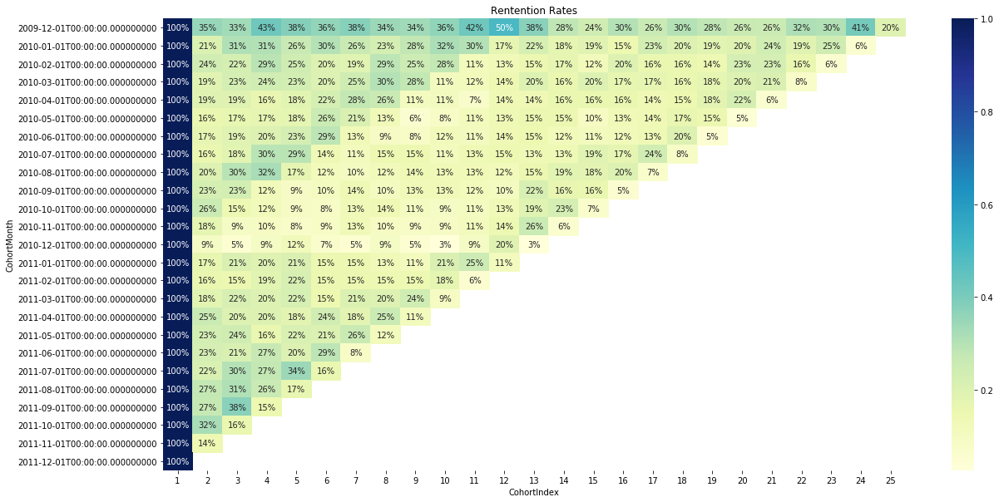

In [24]:
plt.figure(figsize=(20,10))
plt.title('Rentention Rates')
sns.heatmap(data=retention,
           annot=True,
           fmt='.0%',
           #vmin=0.0,
           #vmax=0.5),
cmap='YlGnBu')